In [1]:
import pandas as pd
import plotly.express as px
import tenacity

In [2]:
df = pd.read_csv("../../../data/PatentsView/working/civil_inv_loc_map_data.csv")

In [3]:
df.dtypes

location_id       object
year               int64
city              object
state             object
latitude         float64
longitude        float64
inv_cnt_M          int64
inv_cnt_UNK        int64
inv_cnt_F          int64
inv_cnt_TOTAL      int64
dtype: object

In [4]:
df.head()

,location_id,year,city,state,latitude,longitude,inv_cnt_M,inv_cnt_UNK,inv_cnt_F,inv_cnt_TOTAL
0,00006da3-cb90-11eb-9615-121df0c29c1e,1979,Alder,MT,45.3247,-112.1080,1,0,0,1
1,0010f898-cb91-11eb-9615-121df0c29c1e,2019,Wlllacoochee,GA,NaN,NaN,1,0,0,1
2,00171e6a-cb90-11eb-9615-121df0c29c1e,1983,Mount Herman,NJ,39.6176,-74.5943,1,0,0,1
3,002a61fb-cb8f-11eb-9615-121df0c29c1e,1993,Portland,ND,47.4982,-97.3704,1,0,0,1
4,0048bbcf-09bc-11ec-893a-12de62d610b1,2001,Bookings,SD,NaN,NaN,1,0,0,1


In [5]:
df = df.sort_values(by=['year'], ascending=True)

In [6]:
df.head()

,location_id,year,city,state,latitude,longitude,inv_cnt_M,inv_cnt_UNK,inv_cnt_F,inv_cnt_TOTAL
45348,5acc7e10-cb8f-11eb-9615-121df0c29c1e,1976,Charlottesville,VA,38.0401,-78.4777,1,0,0,1
62721,9c96693c-cb8e-11eb-9615-121df0c29c1e,1976,Clinton,IA,41.8798,-90.5331,1,0,0,1
62707,9c750163-cb8e-11eb-9615-121df0c29c1e,1976,Concord,TN,35.9787,-88.8331,2,0,0,2
62698,9c5d04aa-cb8e-11eb-9615-121df0c29c1e,1976,Roseboro,NC,34.9548,-78.5137,1,0,0,1
32557,44479707-cb8e-11eb-9615-121df0c29c1e,1976,Seneca Falls,NY,42.9078,-76.7966,1,0,0,1


In [15]:
fig = px.scatter_geo(df,
                      lat="latitude",
                      lon="longitude",
                      #color="year",
                      color_discrete_sequence=['navy'],
                      size_max=30,
                      #hover_name="city",
                      size="inv_cnt_TOTAL",
                      animation_frame="year",
                      projection="albers usa",
                      #labels={"country_code": "Country"},
                      custom_data=['city', 'state', 'inv_cnt_TOTAL']
                     )

fig.update_traces(marker=dict(
        # color='navy',
        line=dict(
            color='navy',
            width=1
        )    
    )
)

fig.update_traces(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Number of Inventors: %{customdata[2]}')    
for f in fig.frames:
    f.data[0].update(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Number of Inventors: %{customdata[2]}')



fig.update_layout(
        title = 'Civil Engineering Patent Inventor Locations',
        margin=dict(l=20, r=20, t=30, b=0),
        width = 800,
        height = 500,
        geo = dict(  # geo options from: https://plotly.com/python/scatter-plots-on-maps/
            scope='usa',
            projection_type='albers usa',
            showland = True,
            landcolor = 'gainsboro', #"rgb(250, 250, 250)",
            subunitcolor = 'black', #"rgb(217, 217, 217)",
            countrycolor = 'black', #"rgb(217, 217, 217)",
            countrywidth = 0.5,
            subunitwidth = 0.5
        ),
    )

fig.update_layout(sliders=[dict(pad={"t": 15}, len=0.8)])

fig.update_layout(updatemenus=[dict(type='buttons',
                  showactive=False,
                  y=-0.18,
                  x=-0.02,
                  xanchor='left',
                  yanchor='bottom')
                ])


fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 3000

In [10]:
#fig.frames

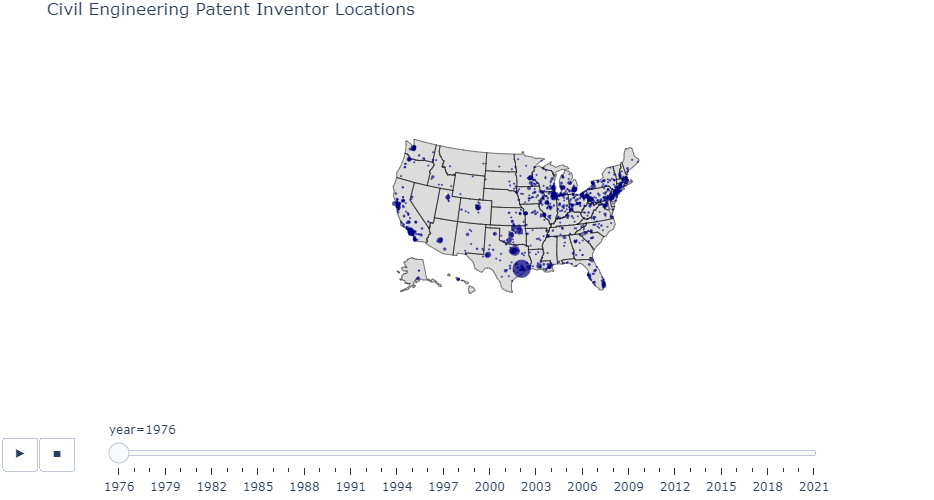

In [16]:
fig.show()

In [11]:
fig.data[0].hovertemplate

'%{customdata[0]}, %{customdata[1]} <br>Number of Inventors: %{customdata[2]}'

In [17]:
# write figure to HTML

import plotly.io as pio
pio.write_html(fig, file='../../../docs/index.html', auto_open=True)

In [23]:
# female inventor location map

fig = px.scatter_geo(df,
                      lat="latitude",
                      lon="longitude",
                      #color="year",
                      color_discrete_sequence=["#E69F00"],
                      size_max=30,
                      #hover_name="city",
                      size="inv_cnt_F",
                      animation_frame="year",
                      projection="albers usa",
                      #labels={"country_code": "Country"},
                      custom_data=['city', 'state', 'inv_cnt_TOTAL']
                     )

fig.update_traces(marker=dict(
        # color='navy',
        line=dict(
            color="#E69F00",
            width=1
        )    
    )
)

fig.update_traces(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Number of Inventors: %{customdata[2]}')    
for f in fig.frames:
    f.data[0].update(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Number of Inventors: %{customdata[2]}')



fig.update_layout(
        title = 'Civil Engineering Female Patent Inventor Locations',
        margin=dict(l=20, r=20, t=30, b=0),
        width = 800,
        height = 500,
        geo = dict(  # geo options from: https://plotly.com/python/scatter-plots-on-maps/
            scope='usa',
            projection_type='albers usa',
            showland = True,
            landcolor = 'gainsboro', #"rgb(250, 250, 250)",
            subunitcolor = 'black', #"rgb(217, 217, 217)",
            countrycolor = 'black', #"rgb(217, 217, 217)",
            countrywidth = 0.5,
            subunitwidth = 0.5
        ),
    )

fig.update_layout(sliders=[dict(pad={"t": 15}, len=0.8)])

fig.update_layout(updatemenus=[dict(type='buttons',
                  showactive=False,
                  y=-0.18,
                  x=-0.02,
                  xanchor='left',
                  yanchor='bottom')
                ])

fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 3000


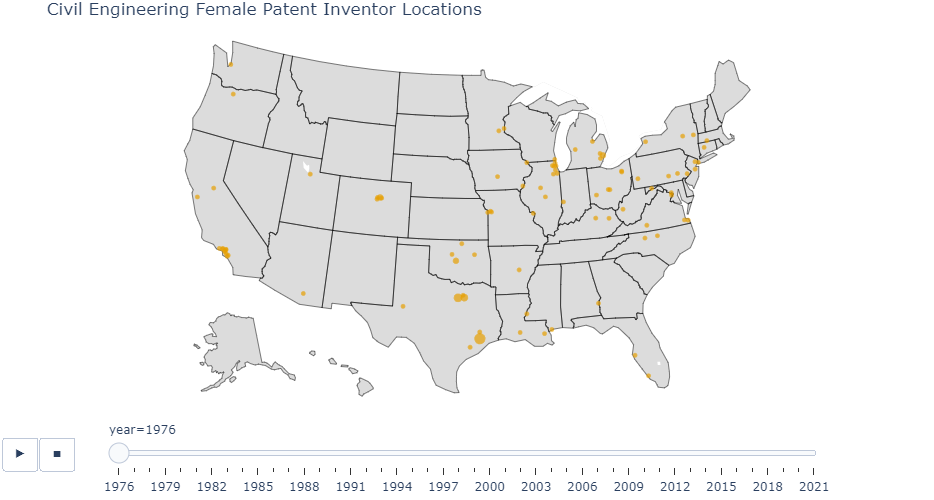

In [24]:
fig.show()

In [25]:
# write figure to HTML

import plotly.io as pio
pio.write_html(fig, file='../../../docs/female_locations.html', auto_open=True)